In [10]:

import numpy as np
import pandas as pd
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

from utils import set_to_nan_based_on_likelihood, plot_polar_plot



# phy_df = pd.read_hdf(r"\\rhea\E\ephys\20240608\WT0008LN\FM\20240608_WT0008LN_M_FM_DMS1_angie_ephys_topDLCephys.h5",'phy_df')
# pd.read_csv("bodyDirection.csv")
# #vid_file = find('*TOP1.avi',path)


In [ ]:
#Imports
import os, fnmatch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy import stats
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
import cv2
from PIL import Image
from tkinter import Tk
from tkinter.filedialog import askdirectory

from speed import speedPlots
from body_direction import body_direction
from Egocentric import *
from Head_direction import *
from egocentric_head import *
from place_cells import *
from utils import *

# Find file
def find(pattern, path):
    result = []
    for root, dirs, files in os.walk(path):
        for name in files: 
            if fnmatch.fnmatch(name,pattern): 
                result.append(os.path.join(root,name))
    if len(result)==1:
        result = result[0]
    return result

#find directory
def findDir(pattern, path):
    result = []
    for root, dirs, files in os.walk(path):
        for name in dirs: 
            if fnmatch.fnmatch(name,pattern): 
                result.append(os.path.join(root,name))
    if len(result)==1:
        result = result[0]
    return result


# File/Video Initialization
root = Tk()
root.withdraw() 
path = r'\\rhea\E\20240710\WT00018RN'

lightPath = findDir("FM_LIGHT", path)
print(lightPath)
dlc_phy_file_light = find('*topDLCephys.h5',lightPath)

dlc_df_light = pd.read_hdf(dlc_phy_file_light, 'dlc_df')
phy_df_light = pd.read_hdf(dlc_phy_file_light,'phy_df')


darkPath = findDir("FM_DARK", path)
print(darkPath)
dlc_phy_file_light = find('*topDLCephys.h5',lightPath)

dlc_phy_file_dark = find('*topDLCephys.h5',darkPath) 

dlc_df_dark = pd.read_hdf(dlc_phy_file_dark, 'dlc_df')
phy_df_dark = pd.read_hdf(dlc_phy_file_dark,'phy_df')
#vid_file = find('*TOP1.avi',path)

root_folder = os.path.dirname(darkPath)

fps = 59.99
likelihood_threshold = 0.95
model_dt = 1/fps # Frame duration in seconds
bin_width = 20 #bin width angles
speed_threshold=0.25
ebc_angle_bin_size = 12
ebc_dist_bin_size = 160
pixels_per_cm = (dlc_df_light.iloc[0]['top_right_corner x'] - dlc_df_light.iloc[0]['top_left_corner x']) / 60

head_plot_data_light, head_bin_edges_light = head_direction(dlc_df_light, phy_df_light, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_light,speed_threshold)
head_plot_data_dark, head_bin_edges_dark = head_direction(dlc_df_dark, phy_df_dark, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_dark, speed_threshold)

body_plot_data_light, body_bin_edges_light = body_direction(dlc_df_light, phy_df_light, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_light, speed_threshold)
body_plot_data_dark, body_bin_edges_dark = body_direction(dlc_df_dark, phy_df_dark, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_dark,speed_threshold)

place_cell_plots_light, x_edges_light, y_edges_light  = place_cells(dlc_df_light, phy_df_light, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_light,speed_threshold)
place_cell_plots_dark, x_edges_dark, y_edges_dark  = place_cells(dlc_df_dark, phy_df_dark, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_dark,speed_threshold)

velocity_list_light, spike_list_light, spike_avg_list_light, std_error_lower_light, std_error_upper_light, timeInSeconds_light = speedPlots(dlc_df_light, phy_df_light, dlc_phy_file_light)
velocity_list_dark, spike_list_dark, spike_avg_list_dark, std_error_lower_dark, std_error_upper_dark, timeInSeconds_dark = speedPlots(dlc_df_dark, phy_df_dark, dlc_phy_file_dark)

head_ebc_plot_data_light, head_distance_bins_light  = egocentric_head(dlc_df_light, phy_df_light, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_light,speed_threshold,ebc_angle_bin_size,ebc_dist_bin_size)
head_ebc_plot_data_dark, head_distance_bins_dark  = egocentric_head(dlc_df_dark, phy_df_dark, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_dark,speed_threshold,ebc_angle_bin_size,ebc_dist_bin_size)

body_ebc_plot_data_light, body_distance_bins_light = egocentric_body(dlc_df_light, phy_df_light, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_light,speed_threshold,ebc_angle_bin_size,ebc_dist_bin_size)
body_ebc_plot_data_dark, body_distance_bins_dark = egocentric_body(dlc_df_dark, phy_df_dark, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_dark,speed_threshold,ebc_angle_bin_size,ebc_dist_bin_size)


In [ ]:
from Head_direction import *
head_plot_data_light, head_bin_edges_light = head_direction(dlc_df_light, phy_df_light, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_light,speed_threshold)
# head_plot_data_dark, head_bin_edges_dark = head_direction(dlc_df_dark, phy_df_dark, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file_dark, speed_threshold)

In [32]:
np.amax(place_cell_plots_light[i])
np.amax(place_cell_plots_dark[i])

0.33

C:\Users\plab\AppData\Local\Temp\ipykernel_35184\2838671273.py:9: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax1 = plt.subplot(3,4,1,projection='polar')
C:\Users\plab\AppData\Local\Temp\ipykernel_35184\2838671273.py:19: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax2 = plt.subplot(3,4,2,projection='polar')
C:\Users\plab\AppData\Local\Temp\ipykernel_35184\2838671273.py:34: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax3 = plt.subplot(3,4,5,projection='polar')
C:\Users\plab\AppData\Local\Temp\ipykernel_35184\2838671273.py:55: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated si

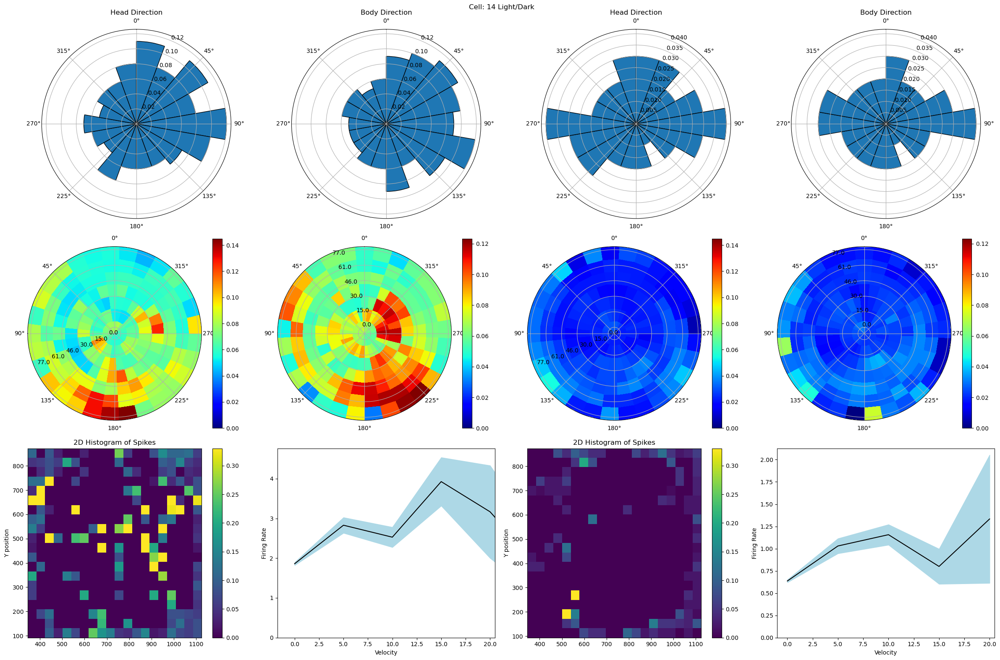

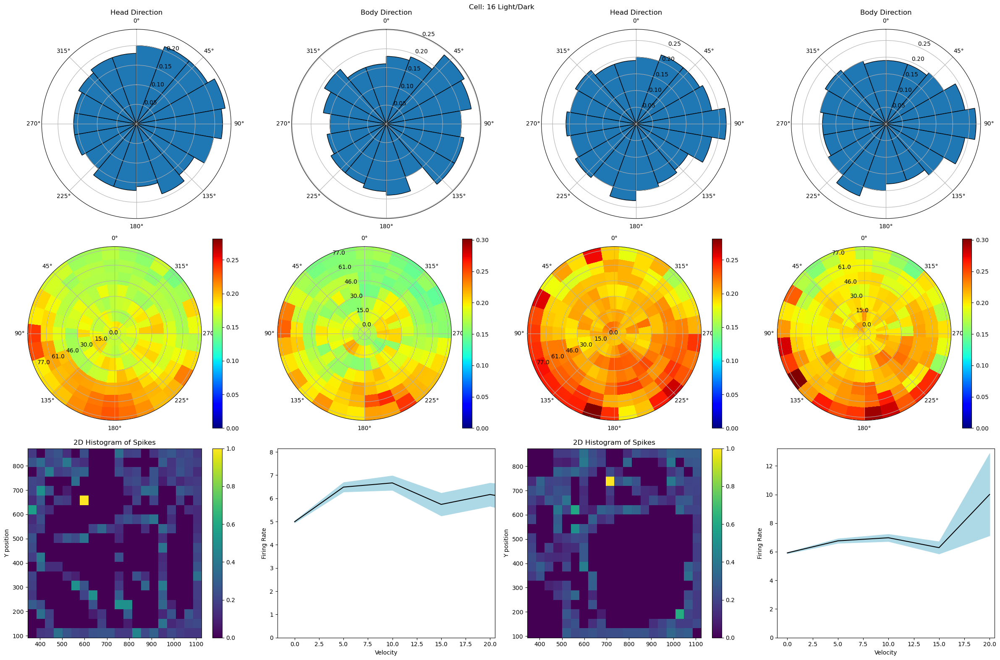

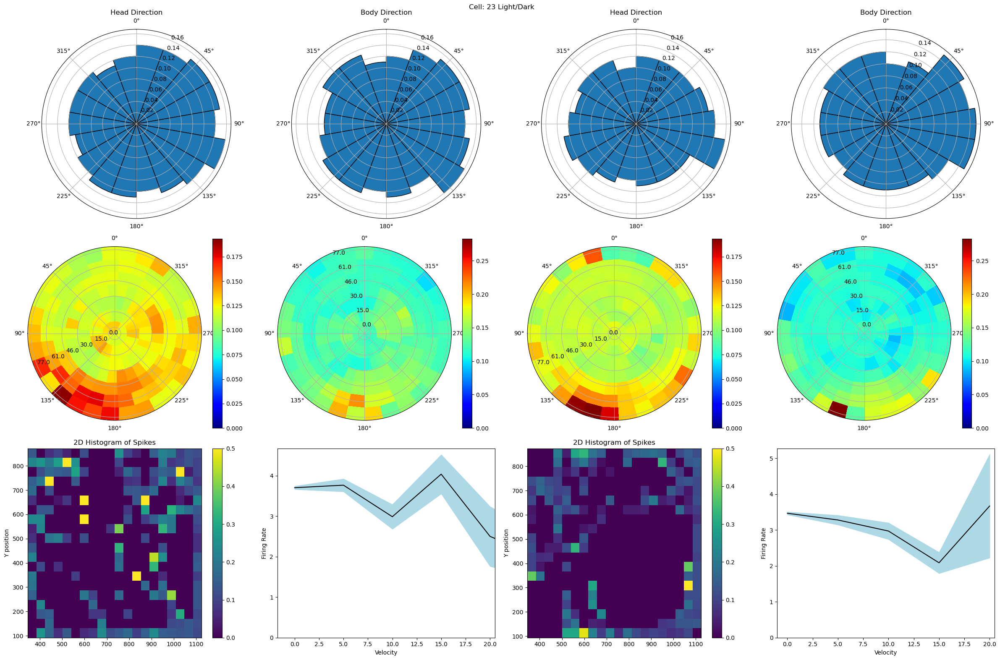

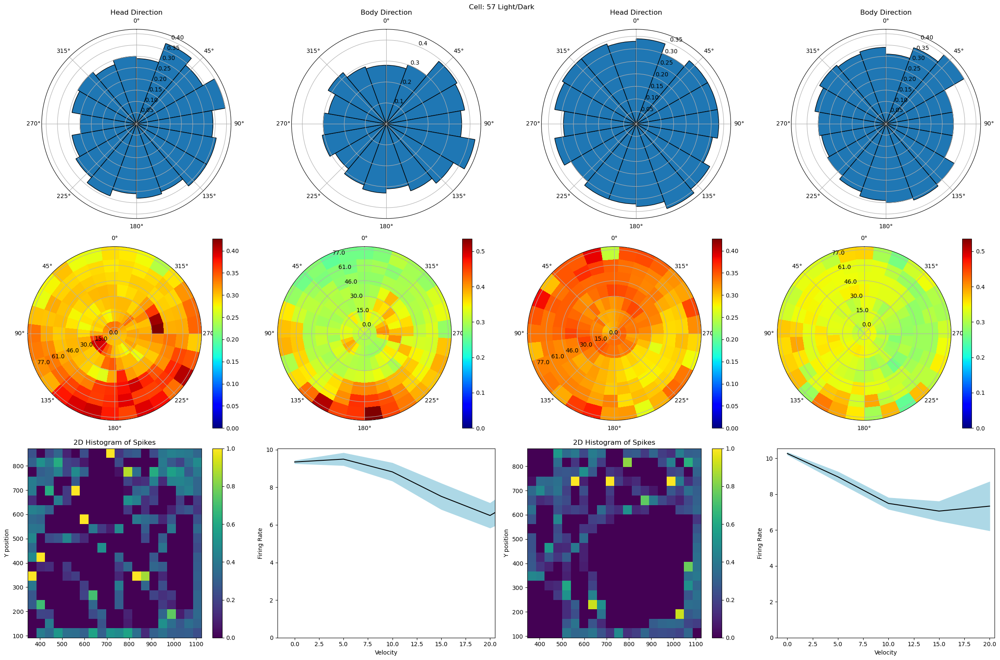

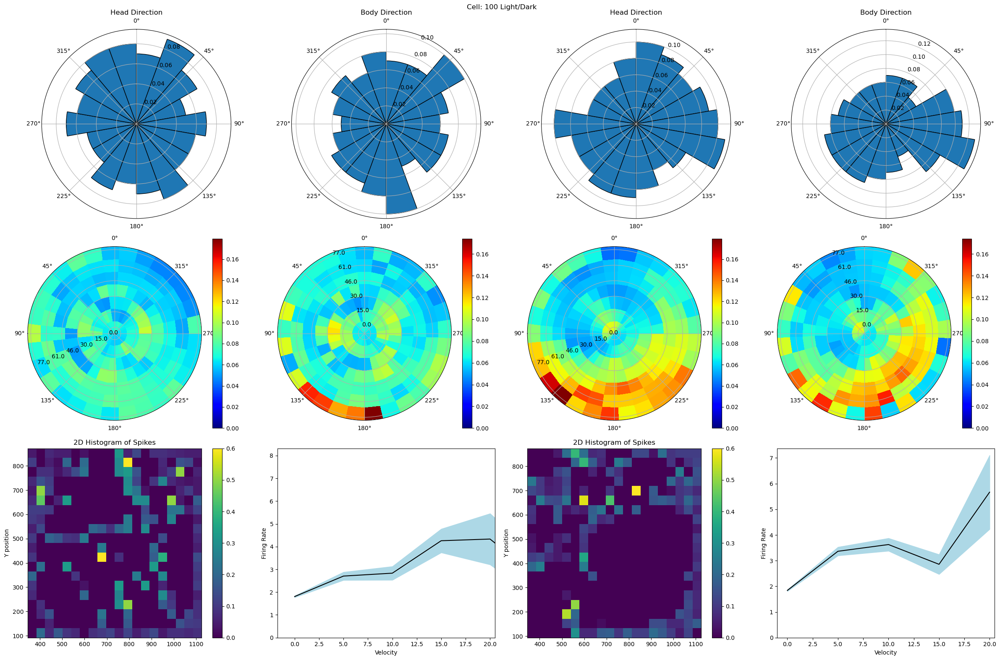

...

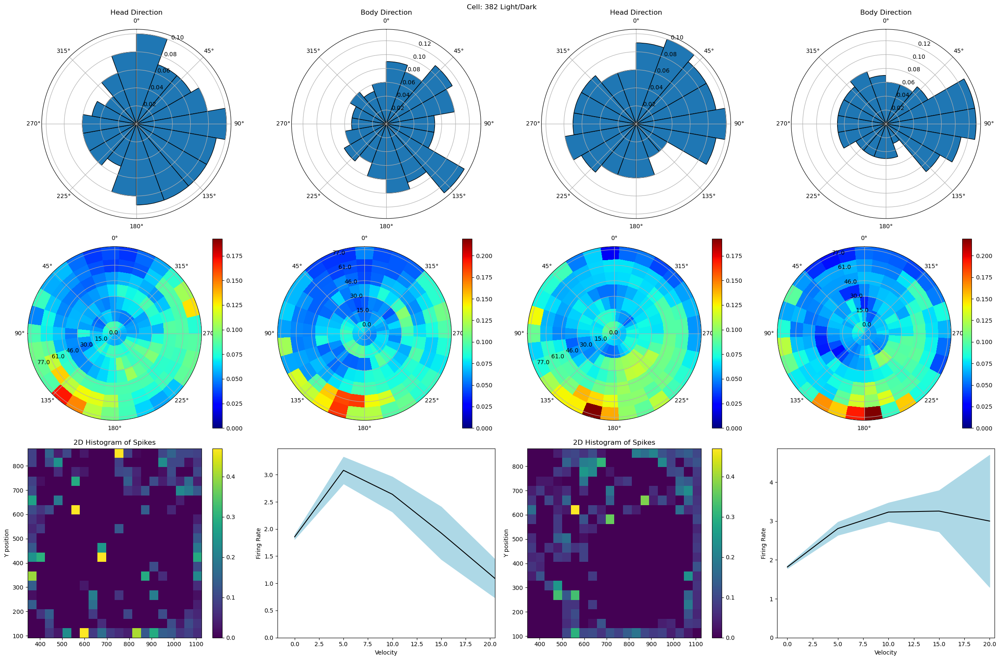

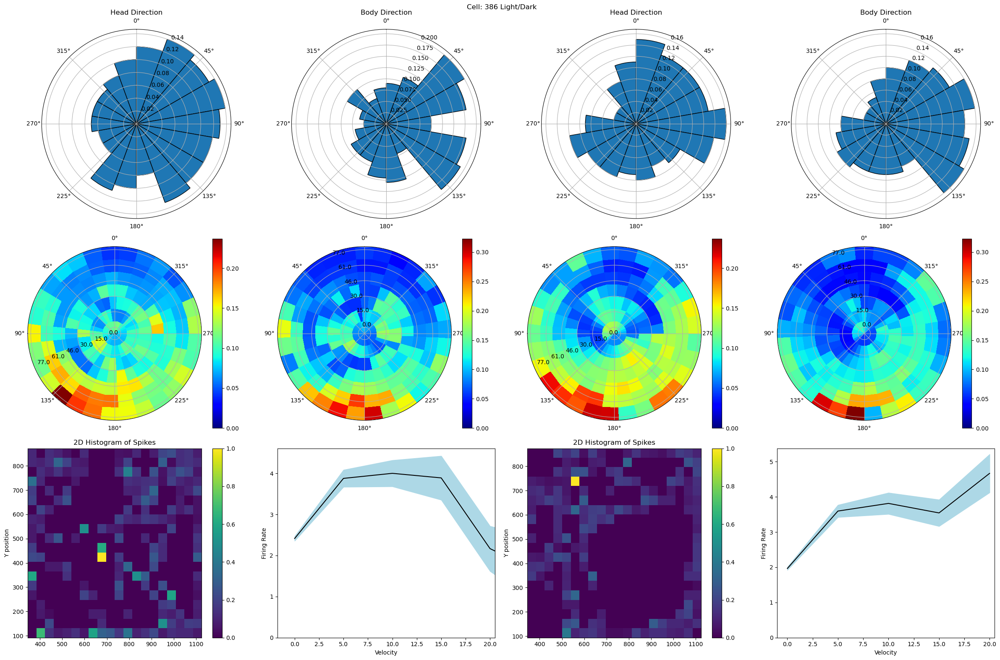

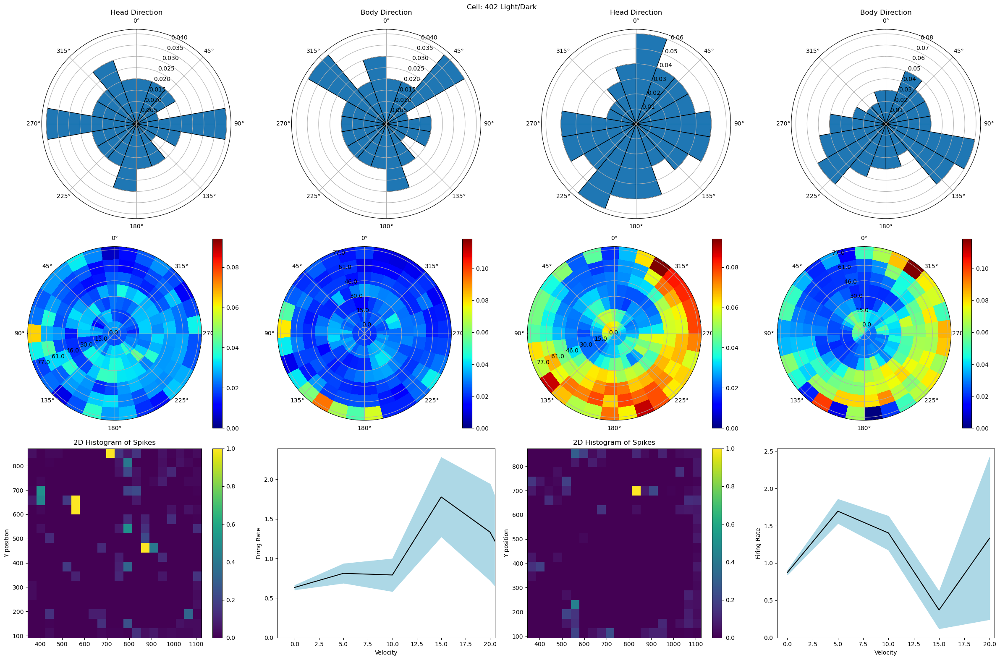

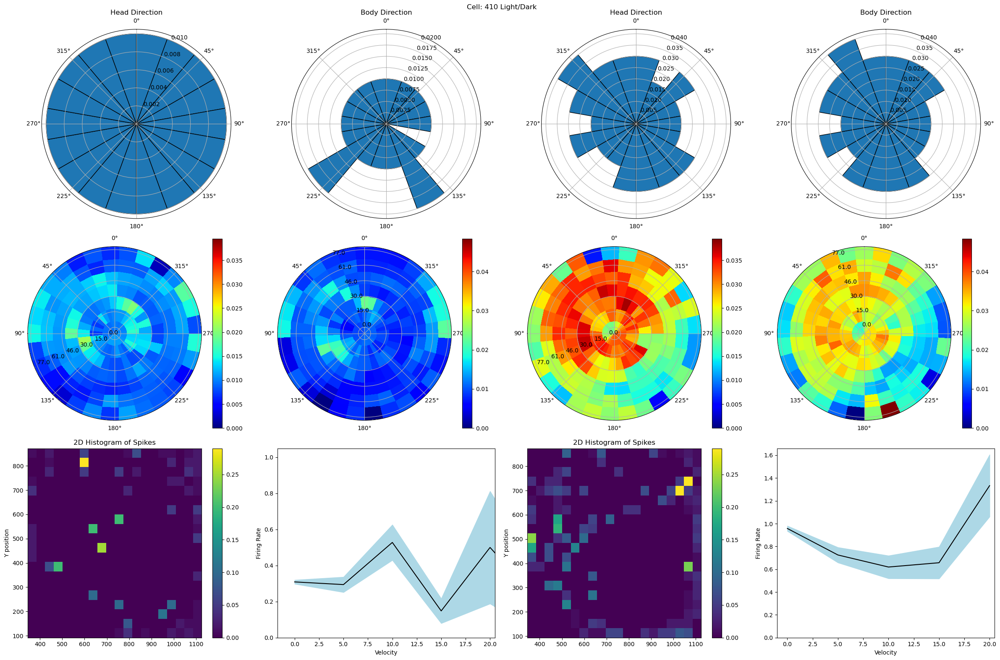

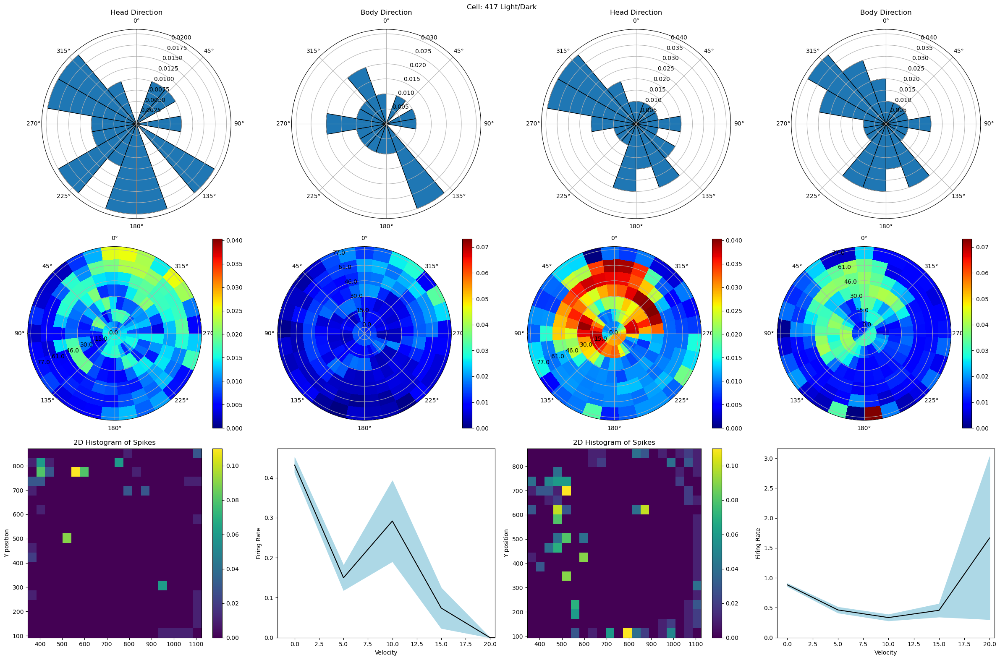

In [33]:
with PdfPages(root_folder + "\LightVsDark.pdf") as pdf:
    
    for i in range(len(head_plot_data_light)):
        #LIGHT
        fig, axs = plt.subplots(3,4, figsize=(24, 16))
        fig.suptitle("Cell: "+ str(phy_df_light.index[i]) + " light")

        #Head_direction
        ax1 = plt.subplot(3,4,1,projection='polar')
        bin_centers = (head_bin_edges_light[:-1] + head_bin_edges_light[1:]) / 2
        bin_centers_rad = np.deg2rad(bin_centers)
        ax1.bar(bin_centers_rad, head_plot_data_light[i], width=np.deg2rad(bin_width), edgecolor='k')
        # Add labels and title
        ax1.set_title('Head Direction')
        ax1.set_theta_zero_location('N')  # Set 0 degrees to the top
        ax1.set_theta_direction(-1)  # Clockwise

        #Body_direction
        ax2 = plt.subplot(3,4,2,projection='polar')
        bin_centers = (body_bin_edges_light[:-1] + body_bin_edges_light[1:]) / 2
        bin_centers_rad = np.deg2rad(bin_centers)
        ax2.bar(bin_centers_rad, body_plot_data_light[i], width=np.deg2rad(bin_width), edgecolor='k')
        # Add labels and title
        ax2.set_title('Body Direction')
        ax2.set_theta_zero_location('N')  # Set 0 degrees to the top
        ax2.set_theta_direction(-1)  # Clockwise

        #find vmax for each head cell
        lightMax = head_ebc_plot_data_light[i].max()
        darkMax = head_ebc_plot_data_dark[i].max()
        headMax = max(lightMax, darkMax)
        
        #ebc head
        ax3 = plt.subplot(3,4,5,projection='polar')
        rbins = head_distance_bins_light.copy()
        abins = np.linspace(0,2*np.pi, (360//ebc_angle_bin_size))

        A, R = np.meshgrid(abins, rbins)


        pc = ax3.pcolormesh(A, R, head_ebc_plot_data_light[i], cmap="jet", vmin=0, vmax=headMax)
        ax3.set_theta_direction(1)
        ax3.set_theta_offset(np.pi)
        ax3.set_thetagrids([0, 45, 90, 135, 180, 225, 270, 315], labels=['90°', '135°', '180°', '225°', '270°', '315°', '0°', '45°'])
        ax3.set_rticks([0, 200, 400, 600, 800, 1000],labels=np.floor(np.arange(0, 1000 / pixels_per_cm + 1, 200/pixels_per_cm)))  # Less radial ticks

        fig.colorbar(pc)

        #find vmax for each body cell
        lightMax = body_ebc_plot_data_light[i].max()
        darkMax = body_ebc_plot_data_dark[i].max()
        bodyMax = max(lightMax, darkMax)

        #ebc body
        ax4 = plt.subplot(3,4,6,projection='polar')
        rbins = body_distance_bins_light.copy()
        abins = np.linspace(0,2*np.pi, (360//ebc_angle_bin_size))

        A, R = np.meshgrid(abins, rbins)


        pc = ax4.pcolormesh(A, R, body_ebc_plot_data_light[i], cmap="jet", vmin=0, vmax=bodyMax)
        ax4.set_theta_direction(1)
        ax4.set_theta_offset(np.pi / 2.0)
        ax4.set_rticks([0, 200, 400, 600, 800, 1000],labels=np.floor(np.arange(0, 1000 / pixels_per_cm + 1, 200/pixels_per_cm)))  # Less radial ticks
        fig.colorbar(pc)

        place_cell_min = min(np.amax(place_cell_plots_light[i]), np.amax(place_cell_plots_dark[i]))

        ax5 = plt.subplot(3,4,9)
        pc = ax5.imshow(place_cell_plots_light[i], origin='lower', aspect = 'auto', extent=[x_edges_light[0], x_edges_light[-1], y_edges_light[0], y_edges_light[-1]], vmax=place_cell_min)
        fig.colorbar(pc)
        ax5.set_ylabel('Y position')
        ax5.set_title('2D Histogram of Spikes')

        #find min velocity between light and dark
        min_velocity = min(max(velocity_list_light[i]), max(velocity_list_dark[i]))

        #velocity
        ax6 = plt.subplot(3,4,10)
        ax6.plot(np.arange(0, max(velocity_list_light[i]), 5), spike_avg_list_light[i],'k')
        ax6.fill_between(np.arange(0, max(velocity_list_light[i]), 5), std_error_lower_light[i], std_error_upper_light[i],color='#ADD8E6')
        ax6.set_xlabel("Velocity")
        ax6.set_ylabel("Firing Rate")
        ax6.set_title("Firing Rate vs Velocity")
        ax6.set_xlim(xmax=min_velocity)
        ax6.set_ylim(bottom=0)

        #DARK
        # fig, ((ax1,ax2),(ax3,ax4), (ax5, ax6))= plt.subplots(3,2, figsize=(12, 12))
        fig.suptitle("Cell: "+ str(phy_df_dark.index[i]) + " Light/Dark")

        #Head_direction
        ax1 = plt.subplot(3,4,3,projection='polar')
        bin_centers = (head_bin_edges_dark[:-1] + head_bin_edges_dark[1:]) / 2
        bin_centers_rad = np.deg2rad(bin_centers)
        ax1.bar(bin_centers_rad, head_plot_data_dark[i], width=np.deg2rad(bin_width), edgecolor='k')
        # Add labels and title
        ax1.set_title('Head Direction')
        ax1.set_theta_zero_location('N')  # Set 0 degrees to the top
        ax1.set_theta_direction(-1)  # Clockwise

        #Body_direction
        ax2 = plt.subplot(3,4,4,projection='polar')
        bin_centers = (body_bin_edges_dark[:-1] + body_bin_edges_dark[1:]) / 2
        bin_centers_rad = np.deg2rad(bin_centers)
        ax2.bar(bin_centers_rad, body_plot_data_dark[i], width=np.deg2rad(bin_width), edgecolor='k')
        # Add labels and title
        ax2.set_title('Body Direction')
        ax2.set_theta_zero_location('N')  # Set 0 degrees to the top
        ax2.set_theta_direction(-1)  # Clockwise

        #ebc head
        ax3 = plt.subplot(3,4,7,projection='polar')
        rbins = head_distance_bins_dark.copy()
        abins = np.linspace(0,2*np.pi, (360//ebc_angle_bin_size))

        A, R = np.meshgrid(abins, rbins)


        pc = ax3.pcolormesh(A, R, head_ebc_plot_data_dark[i], cmap="jet", vmin=0, vmax=headMax)
        ax3.set_theta_direction(1)
        ax3.set_theta_offset(np.pi)
        ax3.set_thetagrids([0, 45, 90, 135, 180, 225, 270, 315], labels=['90°', '135°', '180°', '225°', '270°', '315°', '0°', '45°'])
        ax3.set_rticks([0, 200, 400, 600, 800, 1000],labels=np.floor(np.arange(0, 1000 / pixels_per_cm + 1, 200/pixels_per_cm)))  # Less radial ticks

        fig.colorbar(pc)

        #ebc body
        ax4 = plt.subplot(3,4,8,projection='polar')
        rbins = body_distance_bins_dark.copy()
        abins = np.linspace(0,2*np.pi, (360//ebc_angle_bin_size))

        A, R = np.meshgrid(abins, rbins)


        pc = ax4.pcolormesh(A, R, body_ebc_plot_data_dark[i], cmap="jet", vmin = 0, vmax=bodyMax)
        ax4.set_theta_direction(1)
        ax4.set_theta_offset(np.pi / 2.0)
        ax4.set_rticks([0, 200, 400, 600, 800, 1000],labels=np.floor(np.arange(0, 1000 / pixels_per_cm + 1, 200/pixels_per_cm)))  # Less radial ticks
        fig.colorbar(pc)


        ax5 = plt.subplot(3,4,11)
        pc = ax5.imshow(place_cell_plots_dark[i], origin='lower', aspect = 'auto', extent=[x_edges_dark[0], x_edges_dark[-1], y_edges_dark[0], y_edges_dark[-1]], vmax=place_cell_min)
        fig.colorbar(pc)
        ax5.set_ylabel('Y position')
        ax5.set_title('2D Histogram of Spikes')
        

        ax6 = plt.subplot(3,4,12)
        ax6.plot(np.arange(0, max(velocity_list_dark[i]), 5), spike_avg_list_dark[i],'k')
        ax6.fill_between(np.arange(0, max(velocity_list_dark[i]), 5), std_error_lower_dark[i], std_error_upper_dark[i],color='#ADD8E6')
        ax6.set_xlabel("Velocity")
        ax6.set_ylabel("Firing Rate")
        ax6.set_title("Firing Rate vs Velocity")
        ax6.set_xlim(xmax=min_velocity)
        ax6.set_ylim(bottom=0)

        fig.tight_layout()

        pdf.savefig(fig)

In [15]:
pixels_per_cm = (dlc_df_light.iloc[5000]['top_right_corner x'] - dlc_df_light.iloc[5000]['top_left_corner x']) / 60
pixels_per_cm

12.978917439778646

In [1]:
#Imports
import os, fnmatch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy import stats
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
import cv2
from PIL import Image
from tkinter import Tk
from tkinter.filedialog import askdirectory

from speed import speedPlots
from body_direction import body_direction
from Egocentric import *
from Head_direction import *
from egocentric_head import *
from place_cells import *
from utils import *

# Find file
def find(pattern, path):
    result = []
    for root, dirs, files in os.walk(path):
        for name in files: 
            if fnmatch.fnmatch(name,pattern): 
                result.append(os.path.join(root,name))
    if len(result)==1:
        result = result[0]
    return result

In [24]:
root = Tk()
root.withdraw() 
# path = askdirectory(title='Choose experiment folder', initialdir=r'\\rhea\E') # show an "Open" dialog box and return the path to the selected file
path = r'\\rhea\E\20240704'
lightPath = find('*.avi', path)
print('you have selected: ', lightPath)
root_folder = os.path.dirname(path)

you have selected:  ['\\\\rhea\\E\\20240704\\WT00016R1\\FM_DARK\\20240704_WT00016R1_M_FM_DARK_DMS_angie_TOP1.avi', '\\\\rhea\\E\\20240704\\WT00016R1\\FM_LIGHT\\20240704_WT00016R1_M_FM_LIGHT_DMS_angie_TOP1.avi']


In [21]:
with PdfPages(root_folder + "_allPlots.pdf") as pdf:
    print(pdf)

In [27]:
root_folder = os.walk(os.listdir(path)[0])
root_folder

<generator object walk at 0x0000018EBB54F5F0>

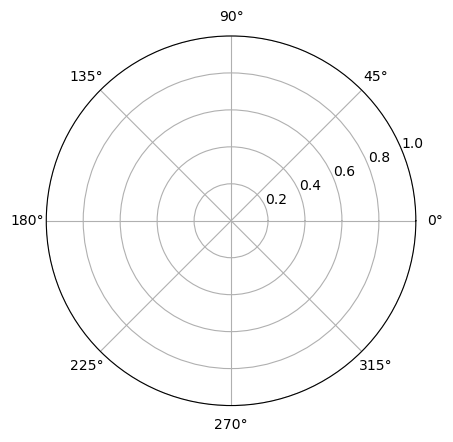

In [11]:
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})

In [6]:
dlc_phy_file = r"\\rhea\D\ephys\20240618\WT00012R2\FM\20240618_WT00012R2_M_FM_DMS1_angie_ephys_topDLCephys.h5"

dlc_df = pd.read_hdf(dlc_phy_file, 'dlc_df')
phy_df = pd.read_hdf(dlc_phy_file,'phy_df')
#vid_file = find('*TOP1.avi',path)

fps = 59.99
likelihood_threshold = 0.95
model_dt = 1/fps # Frame duration in seconds
bin_width = 20 #bin width angles


# dlc_df['time'] = np.arange(len(dlc_df))/fps
### Make time bins from dlc df
# align_t = filtered_df['time']
# model_t = np.arange(0, np.max(align_t), model_dt)

KeyError: 'No object named dlc_df in the file'

In [ ]:
spike_times = phy_df.loc[i]['spikeT']

#removing spike times after camera stopped
spike_times = spike_times[spike_times<=max(model_t)]

#binning spikes
sp_count_ind = np.digitize(spike_times,bins = model_t)

#-1 because np.digitze is 1-indexed
sp_count_ind = [i-1 for i in sp_count_ind]

sp_count_ind = [i for i in sp_count_ind if i in model_data_df.index]

cell_spike_angles = model_data_df['body_angle'][sp_count_ind]

cell_bin_counts, bin_edges = np.histogram(cell_spike_angles, bins=bin_angles)

bin_spike_counts_avg = np.round(np.divide(cell_bin_counts,bin_counts),2)

Generating speedPlots...
Generating bodyDirection...


d:\Pipeline\STA_Pipeline\utils.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})


217771
Generating egocentric graphs...
Generating headDirection...


C:\Users\plab\AppData\Local\Temp\ipykernel_29668\3448720903.py:103: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


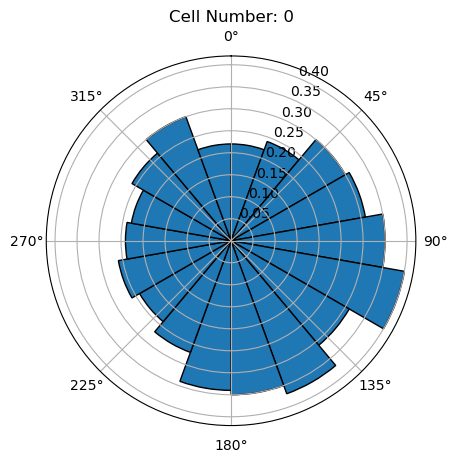

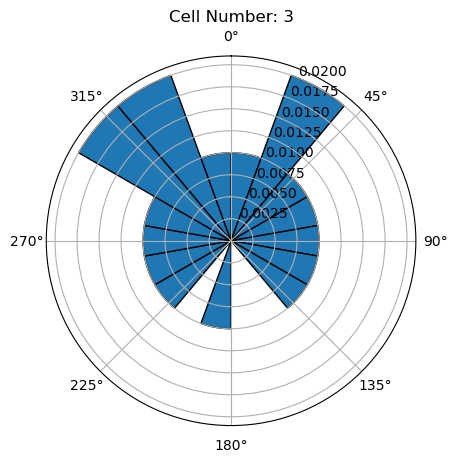

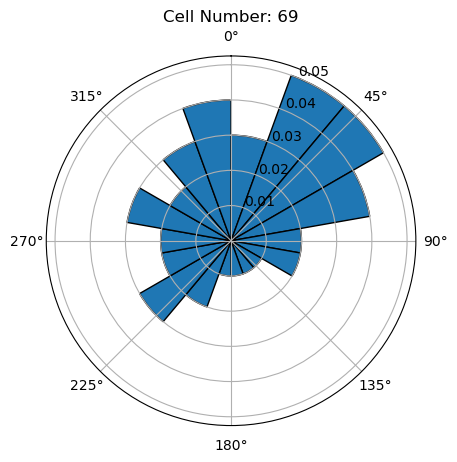

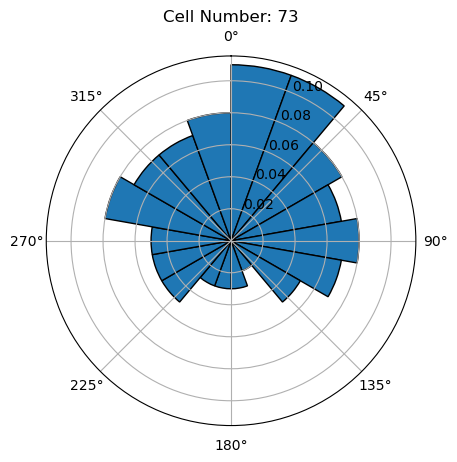

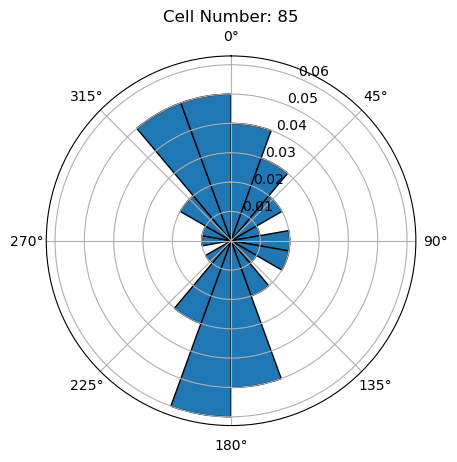

...

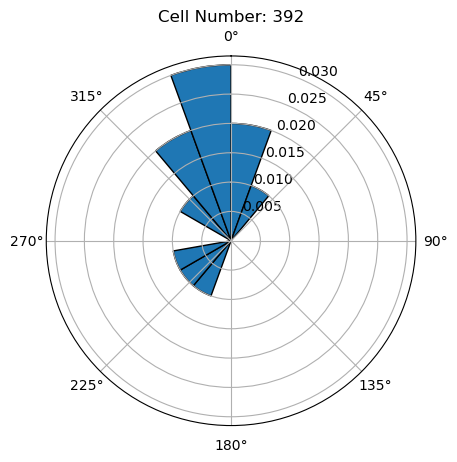

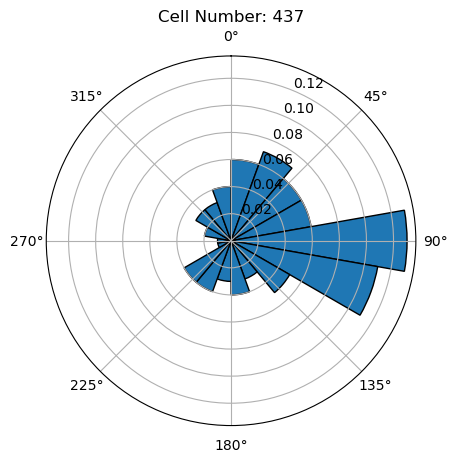

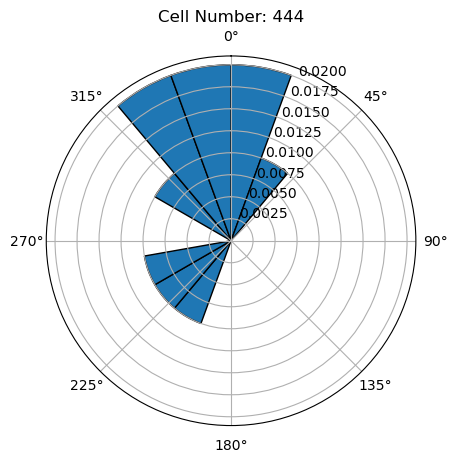

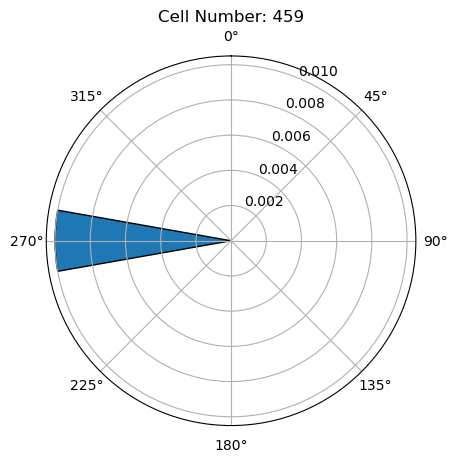

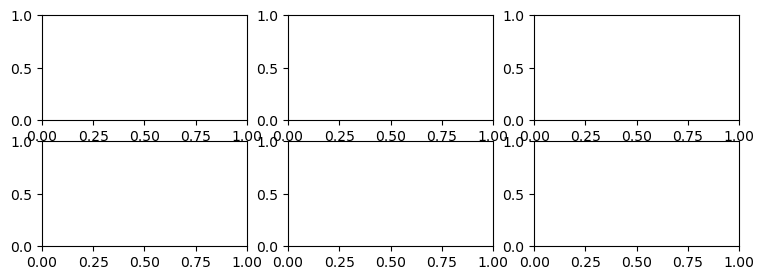

In [3]:
#Imports
import os, fnmatch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy import stats
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
import cv2
from PIL import Image
from tkinter import Tk
from tkinter.filedialog import askdirectory

from speed import speedPlots
from body_direction import body_direction
from Egocentric import *
from Head_direction import *

# Find file
def find(pattern, path):
    result = []
    for root, dirs, files in os.walk(path):
        for name in files: 
            if fnmatch.fnmatch(name,pattern): 
                result.append(os.path.join(root,name))
    if len(result)==1:
        result = result[0]
    return result


#File/Video Initialization
# root = Tk()
# root.withdraw() 
# path = askdirectory(title='Choose experiment folder', initialdir=r'\\rhea\D\ephys') # show an "Open" dialog box and return the path to the selected file
# print('you have selected: ', path)

# dlc_phy_file = find('*topDLCephys.h5',path)
dlc_phy_file = r"\\rhea\D\ephys\20240608\WT0008LN\FM\20240608_WT0008LN_M_FM_DMS1_angie_ephys_topDLCephys.h5"

dlc_df = pd.read_hdf(r"\\rhea\D\ephys\20240608\WT0008LN\FM\20240608_WT0008LN_M_FM_DMS1_angie_ephys_topDLCephys.h5", 'dlc_df')
phy_df = pd.read_hdf(r"\\rhea\D\ephys\20240608\WT0008LN\FM\20240608_WT0008LN_M_FM_DMS1_angie_ephys_topDLCephys.h5",'phy_df')
#vid_file = find('*TOP1.avi',path)

fps = 59.99
likelihood_threshold = 0.95
model_dt = 1/fps # Frame duration in seconds
bin_width = 20 #bin width angles

'''
# Adding timestamps to dlc file and only considering columns of interest
dlc_df['time'] = np.arange(len(dlc_df))/fps

columns_of_interest = ['center_neck', 'center_haunch', 'time']

    # filtering points based on likelihood and removing likelihood columns
df_of_interest = dlc_df.filter(regex='|'.join(columns_of_interest))

# filtering points based on likelihood and removing likelihood columns
filtered_df = set_to_nan_based_on_likelihood(df_of_interest, likelihood_threshold)
filtered_df = filtered_df.drop(columns=filtered_df.filter(regex='likelihood').columns)

### Make time bins from dlc df
align_t = filtered_df['time']
model_t = np.arange(0, np.max(align_t), model_dt)


model_data = {}
for col in filtered_df.columns:
    if 'time' not in col:
        interp = interp1d(filtered_df['time'],filtered_df[col],axis=0, bounds_error=False, fill_value='extrapolate')
        model_data[col] = interp(model_t + model_dt / 2)

# Convert model_data to DataFrame for easier handling
model_data_df = pd.DataFrame(model_data)
'''
print("Generating speedPlots...")
# speedGraphs = speedPlots(dlc_df, phy_df, dlc_phy_file)
print("Generating bodyDirection...")
bodyDirGraphs = body_direction(dlc_df, phy_df, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file)
print("Generating egocentric graphs...")
# egocentricGraphs = egocentric_body(dlc_df, phy_df, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file)
print("Generating headDirection...")
# headDirGraphs = head_direction(dlc_df, phy_df, fps, likelihood_threshold, model_dt, bin_width, dlc_phy_file)
#egocentric_head

pdf_file = dlc_phy_file[:-3]+'_allPlots.pdf'
pp = PdfPages(pdf_file)

fig, axs = plt.subplots(2,3,figsize=(9,3))
axs = axs.ravel()
ax = axs[0]
# ax.plot(speedGraphs[0])
# ax = axs[3]
axs[0] = bodyDirGraphs[0]
axs[1] = bodyDirGraphs[0]
axs[2] = bodyDirGraphs[0]
axs[3] = bodyDirGraphs[0]
axs[4] = bodyDirGraphs[0]
axs[5] = bodyDirGraphs[0]
fig.show()
# ax = axs[4]
# # ax.plot(egocentricGraphs[0])
# ax = axs[5]
# ax.plot(headDirGraphs[0])
# ax = axs[6]

# pp.savefig(speedGraphs[0])
# pp.savefig(bodyDirGraphs[0])
# pp.savefig(headDirGraphs[0])

pp.close()


In [17]:
from utils import *
frame_velocity = calcFrameVelocity(['right_haunch'], dlc_df, fps)
print(len(frame_velocity[frame_velocity < 10]))

190050


In [19]:
len(frame_velocity)

217771

In [27]:
print (len(body_plot_data[0]))

18


In [28]:
print(len(head_plot_data[0]))

18


In [29]:
print(head_plot_data[0])

[0.23 0.26 0.29 0.33 0.34 0.34 0.33 0.36 0.32 0.27 0.23 0.2  0.22 0.24
 0.19 0.17 0.13 0.13]


In [30]:
    columns_of_interest = ['left_drive', 'right_drive', 'time']
    dlc_df['time'] = np.arange(len(dlc_df))/fps

    #filter and interpolate
    model_data_df,model_t = filter_and_interpolate(dlc_df,columns_of_interest,likelihood_threshold,model_dt)

In [35]:
len(model_t)

217771

In [36]:
len(frame_velocity)

217771

In [20]:
spike_times = phy_df['spikeT'][0]

In [22]:
len(spike_times)

48337